In [ ]:
import numpy as np
import cv2
import os
import random
import matplotlib.pyplot as plt
from collections import deque
from keras.utils import to_categorical
from keras.models import Model
from keras.layers import Input, Dense, Conv2D, Flatten, concatenate
from keras.optimizers import Adam, RMSprop
from keras import backend as K
from IPython.display import clear_output
from IPython.display import Image
import imageio
import shutil

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Классы и функции

In [ ]:
class Minesweeper(object):

  '''
  Class of minesweeper game
  Input parameters:
    - mines_count - number of mines on playfield
    - playfield_size - length of square playfield side
  '''

  def __init__(self, mines_count, playfield_h, playfield_w):
    self.mines_count = mines_count
    self.playfield_h = playfield_h
    self.playfield_w = playfield_w
    # Actions for locate all points around current point (clockwise)
    self.actions = [(-1,-1), (-1,0), (-1,1), (0,1), (1,1), (1,0), (1,-1), (0,-1)]
    # Field with information about the number of participation of each cell in the prediction
    self.dev_field = np.zeros((self.playfield_h, self.playfield_w))
    # Field with accumulation all predictions value
    self.prediction_field = np.zeros((self.playfield_h, self.playfield_w))

  # Create fake playfield
  def _create_playground(self):
    self.playground = np.zeros((self.playfield_h+2,self. playfield_w+2))
    return self.playground

  # Create filed for mines placement
  def _create_minesfield(self):
    self.minesfield = np.full((self.playfield_h, self.playfield_w), 9)
    return self.minesfield

  # First step coordinates
  def _first_step(self):
    x = np.random.randint(0, self.playfield_h)
    y = np.random.randint(0, self.playfield_w)
    return (x, y)

  # Create mines in random places exept first_step_coord
  def _place_mines(self):
    first_step_coord = self._first_step()

    first_point_surround = []
    for act in self.actions:
      x1 = first_step_coord[0] + act[0]
      y1 = first_step_coord[1] + act[1]
      first_point_surround.append((x1, y1))

    self.mines_coord = []
    while len(self.mines_coord) < self.mines_count:
      x = np.random.randint(0, self.playfield_h)
      y = np.random.randint(0, self.playfield_w)

      if ((x, y) != first_step_coord) and ((x, y) not in self.mines_coord) and ((x, y) not in first_point_surround):
        self.mines_coord.append((x, y))

    return first_step_coord

  # Create stealth playfield with mines around count
  def _mines_number(self):
    mines_round =[]
    for mine in self.mines_coord:
      mines_round.append((mine[0]+1, mine[1]+1))

    field = np.zeros_like(self.playground)

    for i in range(1, self.playfield_h+1):
      for j in range(1, self.playfield_w+1):
        if (i, j) in mines_round:
          continue
        
        field_round = [(i-1,j-1), (i-1,j), (i-1,j+1),
                       (i,j-1), (i,j), (i,j+1),
                       (i+1,j-1), (i+1,j), (i+1,j+1)]
        mines_count = 0
        for point in field_round:
          mines_count += self.playground[point]
        field[i,j] = mines_count

    return field[1:-1, 1:-1]

  # Create fake playfield where stored info abount point surrunding
  def _create_playfield(self):
    for mine in self.mines_coord:
      x = mine[0] + 1
      y = mine[1] + 1
      self.playground[(x,y)] = 1

    self.fake_playfield = self._mines_number()

  # Check if step has reason (step in near field of open points)
  def _yolo_move(self, action):
    # action - (x,y) coordinate of current step

    for act in self.actions:
      x1 = action[0] + act[0]
      y1 = action[1] + act[1]
      if (x1, y1) in self.free_point:
        return False
    
    return True

  # Check if step has reason (step in near field of open points)
  def _yolo_move_for_fake(self, action, rct):
    # action - (x,y) coordinate of current step in field 5x5
    # rct - x1,y1,x2,y2 coordinates of 5x5 field in minesweeper playfield 
    # (where x1,y1 - coordinates of top left corner, x2,y2 - coordinates of bottom right corner)

    for act in self.actions:
      x1 = action[0] + act[0]
      y1 = action[1] + act[1]
      if (x1, y1) in self.free_point and x1 in range(rct[0], rct[2]) and y1 in range(rct[1], rct[3]):
        return False
    
    return True

  # Open all connected zeros in playfield (for game acceleration)
  def open_zeros(self):
    
    done = True
    scale_reward = 0
    while done:
      k = 0
      for point in self.free_point.copy():
        if self.minesfield[point] == 0:
          
          for act in self.actions:
            x = point[0] + act[0]
            y = point[1] + act[1]
            if x in range(self.playfield_h) and y in range(self.playfield_w):
              if self.minesfield[(x,y)] == 9:
                k = 1
                scale_reward += 1
                self.free_point.add((x,y))
                self.minesfield[(x,y)] = self.fake_playfield[(x,y)]
      if k == 0:
        return scale_reward


  # Initialize field for game
  def initialize_game(self):

    self._create_playground()

    self.free_point = set()
    first_step_coord = self._place_mines()
    self.free_point.add(first_step_coord)

    self._create_playfield()
    self._create_minesfield()
    self.minesfield[first_step_coord] = self.fake_playfield[first_step_coord]

  # Open minesfield point or die 
  def step(self, action):
    # action - (x,y) coordinate of current step

    x = action[0]
    y = action[1]

    # Check if current step coordinates in mines_coord
    if (x,y) in self.mines_coord:
      self.free_point.add((x,y))
      # self.minesfield[(x,y)] = 10
      reward = -1
      done = True

    # Check if current step coordinates is already done 
    elif (x,y) in self.free_point:
      reward = -0.3
      done = False
      
    else:
      # Add point in set of free points
      self.free_point.add((x,y))
      # Check if current step coordinates is yolo move
      if self._yolo_move((x,y)):
        self.minesfield[(x,y)] = self.fake_playfield[(x,y)]
        reward = -0.3
        done = False
      else:
        # Check if current step coordinates is last free point (win)
        if len(self.free_point) == int(self.playfield_h*self.playfield_w) - self.mines_count:
          self.minesfield[(x,y)] = self.fake_playfield[(x,y)]
          reward = 1
          done = True
        else:
        # Check if current step coordinates is not last free point
          self.minesfield[(x,y)] = self.fake_playfield[(x,y)]
          reward = 0.9
          done = False

    return self.minesfield, reward, done

  # Get reward for fake step in small field (5x5)
  def fake_step(self, action, rct):

    # action - (x,y) coordinate of current step in field 5x5
    # rct - x1,y1,x2,y2 coordinates of 5x5 field in minesweeper playfield 
    # (where x1,y1 - coordinates of top left corner, x2,y2 - coordinates of bottom right corner)

    x = action[0] + rct[0]
    y = action[1] + rct[1]

    # Check if current step coordinates in mines_coord
    if (x,y) in self.mines_coord:
      reward = -1
      done = True
    # Check if current step coordinates is already done 
    elif (x,y) in self.free_point:
      reward = -0.3
      done = False
      
    else:
      # Check if current step coordinates is yolo move
      if self._yolo_move_for_fake((x,y), rct):
        reward = -0.3
        done = False
      else:
      # Check if current step coordinates is not last free point
        reward = 0.9
        done = False

    return reward, done

In [ ]:
class Agent(object):

  '''
  Class of agent for play minesweeper
  Input parameters:
    - dicision_field - Size of suqare side for dicision field
    - epsilon - start value of probability of random step selection
  '''

  def __init__(self, dicision_field, epsilon):

    self.load_model = True # Always loading model if it is exist

    self.checkpoint_dir = checkpoint_dir # Path where model is saved

    self.dicision_field = dicision_field # Size of suqare side for dicision field
    self.num_actions = int(self.dicision_field * self.dicision_field) # Number of possible actions
    self.state_size = (self.dicision_field, self.dicision_field, 10)
    
    self.epsilon = epsilon
    self.epsilon_start, self.epsilon_end = 1.0, 0.1 # Parameters for epsilon_decay_step calculation
    self.exploration_steps = 500000 # Parameters for epsilon_decay_step calculation
    self.epsilon_decay_step = (self.epsilon_start - self.epsilon_end) / self.exploration_steps

    self.batch_size = 16 # Batch size for model learning
    self.train_start = 20000 # Minimal memory size for start learning
    self.update_target_rate = 20000 # After each ... steps update target model
    self.discount_factor = 0.0 # Discount factor in Bellman equation
    self.memory = deque(maxlen=40000)  # Number of play situations for learning

    self.model = self.build_model()
    self.target_model = self.build_model()
    self.update_target_model()
    
    self.avg_q_max, self.avg_loss = 0., 0.

    if self.load_model:
      if os.path.exists(os.path.join(self.checkpoint_dir, 'curr_ckpt.h5')) is True:
        self.model.load_weights(os.path.join(self.checkpoint_dir, 'curr_ckpt.h5'))

  def build_model(self):
    input = Input(shape=(self.state_size))

    x1 = Conv2D(32, (5,5), padding='same', activation='tanh')(input)
    x2 = Conv2D(32, (3,3), padding='same', activation='tanh')(input)
    x = concatenate([x1, x2])
    x = Conv2D(64, (3,3), padding='same', activation='linear')(x)
    output = Conv2D(1, (1,1), padding='same', activation='linear')(x)
    # x = Flatten()(x)
    # x = Dense(512, activation='relu')(x)
    # output = Dense(self.num_actions, activation='linear')(x)

    model = Model(input, output)
    model.compile(optimizer=RMSprop(lr=2.5e-4, epsilon=0.01),
                  loss='mse')
    
    return model

  # Load in target model weigths of current model
  def update_target_model(self):
    self.target_model.set_weights(self.model.get_weights())

  # Select action
  def get_action(self, history, free_point_set):
    if np.random.rand() <= self.epsilon:
      total_points = set(np.arange(self.num_actions))
      free_points = set([point[0]*self.dicision_field + point[1] for point in free_point_set])
      selection_points = total_points - free_points
      # print(selection_points)
      return int(random.sample(list(selection_points), 1)[0])
    else:
      q_value = self.model.predict(np.expand_dims(history, axis=0))
      return np.argmax(q_value)

  # Add play situation in memory
  def replay_memory(self, history, action, reward, done):
    self.memory.append((history, action, reward, done))

  # Train current model on batch
  def train_replay(self):
    if len(self.memory) < self.train_start:
      return
    if self.epsilon > self.epsilon_end:
      self.epsilon -= self.epsilon_decay_step

    mini_batch = random.sample(self.memory, self.batch_size)

    history = np.zeros((self.batch_size, self.state_size[0],
                        self.state_size[1], self.state_size[2]))

    target = np.zeros((self.batch_size))

    action, reward, done = [], [], []

    for i in range(self.batch_size):
      history[i] = np.float32(mini_batch[i][0])
      action.append(mini_batch[i][1])
      reward.append(mini_batch[i][2])
      done.append(mini_batch[i][3])

    q_value = self.model.predict(history)

    for i in range(self.batch_size):
      if done[i]:
        target[i] = reward[i]
      else:
        target[i] = reward[i]

      xi = int(action[i] // self.dicision_field)
      yi = int(action[i] - xi * self.dicision_field)
      q_value[i][xi, yi] = target[i]
    
    loss = self.model.train_on_batch(history, q_value)

    self.avg_loss += loss


  def save_model(self):
    self.model.save_weights(os.path.join(self.checkpoint_dir, 'curr_ckpt.h5'))

In [ ]:
def show_result(play, i, free_points, mines_coord):

  '''
  Функция отображения игрового поля
  Входные параметры:
   - play - игровое поле
   - free_points - координаты точек, куда сходили
   - mines_coord - координаты мин
  '''
  
  # fig = plt.figure()
  plt.imshow(play, cmap='Accent')
  plt.axis('off')
  for x in range(play.shape[0]):
    for y in range(play.shape[1]):
      if (x,y) in free_points:
        if (x,y) in mines_coord:
          label = 'boom!'
          plt.text(y, x, label, color='black', ha='center', va='center')
        else:
          label = play[(x, y)]
          plt.text(y, x, label, color='black', ha='center', va='center')

  plt.savefig(os.path.join(result_dir, str(i) + '.jpg'))
  plt.show()

In [ ]:
def train_minesweeper(episodes, episode_start, epsilon, global_step, advanced=False):

  '''
  Algorithm for training the agent to play minesweeper
  Input parameters:
    - episodes - number of game episodes for train
    - episode_start - start episode number (for continue training after loading)
    - epsilon - start value of probability of random step selection
    - global_step - number of iterations of agent learning on batch
    - advanced - flag for to open connected zeros on minesweeper field
  '''

  for episode in range(episode_start, episodes):

    ddone = False
    step = 0
    score = 0
    k = 0
    # Update minesweeper
    test_minesweeper.initialize_game()
    # Get first playfiled state
    history_filed = to_categorical(test_minesweeper.minesfield, 10)

    while not ddone:

      step += 1
      avg_q_max = 0
      pred_step = 0 # steps for current situation
      # Update minesweeper dev_field and prediction_field
      test_minesweeper.dev_field = np.zeros((playfield_h, playfield_w, 1))
      test_minesweeper.prediction_field = np.zeros((playfield_h, playfield_w, 1))

      # Scan playfield with dicision field
      for i in range(2, playfield_h-2):
        for j in range(2, playfield_w-2):
          pred_step += 1
          global_step += 1
          rct = [i-2, j-2, i+3, j+3]
          
          current_field = history_filed[rct[0]:rct[2], rct[1]:rct[3]].copy()

          action = agent.get_action(current_field, test_minesweeper.free_point)

          x = int(action // dicision_field)
          y = int(action - x * dicision_field)

          reward, done = test_minesweeper.fake_step((x,y), rct)
          # Take in memory only information valuable fields (9 - not open -> 9*25 not valuable)
          if np.sum(np.argmax(current_field, axis=2)) != 225:
            agent.replay_memory(current_field, action, reward, done)
          # Train on batch
          agent.train_replay()
          if global_step % agent.update_target_rate == 0:
            agent.update_target_model()
          # Get value for predicted action
          q_val = agent.model.predict(np.expand_dims(current_field, axis=0))[0]
          avg_q_max += np.amax(q_val)
          # Add values in prediction_field and dev_field
          test_minesweeper.prediction_field[rct[0]:rct[2], rct[1]:rct[3]] += q_val
          test_minesweeper.dev_field[rct[0]:rct[2], rct[1]:rct[3]] += np.ones((dicision_field, dicision_field, 1))

      agent.avg_q_max += avg_q_max / pred_step # Count mean avg_q_max value
      test_minesweeper.prediction_field = test_minesweeper.prediction_field / test_minesweeper.dev_field # Count summary prediction_field values

      # Get current step action
      action = np.argmax(test_minesweeper.prediction_field)

      x = int(action // playfield_w)
      y = int(action - x * playfield_w)

      if (x,y) in test_minesweeper.free_point:
        k += 1
        
      # Make step
      history_filed, reward, ddone = test_minesweeper.step((x,y))
      # If need open all connected zeros
      if advanced:
        scale_reward = test_minesweeper.open_zeros()
        reward += 0.9 * scale_reward

      history_filed = to_categorical(history_filed, 10)

      score += reward

      if step > playfield_h*playfield_w or k > 2:
        ddone = True

      if reward == -1:
        total_points = set(np.arange(agent.num_actions))
        free_points = set([point[0]*agent.dicision_field + point[1] for point in test_minesweeper.free_point])
        selection_points = total_points - free_points
        test_minesweeper.free_point = test_minesweeper.free_point - set([(x,y)])
        for action in selection_points:
          x = int(action // dicision_field)
          y = int(action - x * dicision_field)
          observe, reward, done = test_minesweeper.step((x,y))
          next_history = to_categorical(observe, 10)
          agent.replay_memory(current_field, action, reward, done)
          agent.train_replay()
          test_minesweeper.free_point = test_minesweeper.free_point - set([(x,y)])

      if ddone:
        scores.append(score)
        average_scores.append(agent.avg_q_max / float(step))
        print("ep:", episode, "  s.:", round(score,2), "  mem.len:",
              len(agent.memory), "  eps:", round(agent.epsilon,2),
              "  g_step:", global_step, "  av_q:",
              round(agent.avg_q_max / float(step),3), "  av_loss:",
              round(agent.avg_loss / float(step),7))

        agent.avg_q_max, agent.avg_loss = 0, 0

    if episode % 20 == 0:
      agent.save_model()
      step_info = np.array([episode, global_step])
      np.save(os.path.join(checkpoint_dir, 'step_info.npy'), step_info)
      np.save(os.path.join(checkpoint_dir, 'scores.npy'), scores)
      np.save(os.path.join(checkpoint_dir, 'average_scores.npy'), average_scores)

In [ ]:
def test_minesweeper_game():

  '''
  Single episode playback and print information function
  Output parameters:
    - step_filed - list of playfield states during game
  '''

  step_filed = []
  done = False # Flag if game is ended
  step = 0 # Number of steps duirng game
  score = 0 # Total score after game
  k = 0
  # Update minesweeper
  test_minesweeper.initialize_game()
  step_filed.append(test_minesweeper.minesfield.copy())
  # Get first playfiled state
  history = to_categorical(test_minesweeper.minesfield, 10)

  while not done:

    step += 1
    # Update minesweeper dev_field and prediction_field
    test_minesweeper.dev_field = np.zeros((playfield_h, playfield_w, 1))
    test_minesweeper.prediction_field = np.zeros((playfield_h, playfield_w, 1))

    # Scan playfield with dicision field
    for i in range(2, playfield_h-2):
      for j in range(2, playfield_w-2):
        rct = [i-2, j-2, i+3, j+3]

        current_field = history[rct[0]:rct[2], rct[1]:rct[3]].copy()

        action = agent.get_action(current_field, test_minesweeper.free_point)

        x = int(action // dicision_field)
        y = int(action - x * dicision_field)

        reward, done = test_minesweeper.fake_step((x,y), rct)
        # Get value for predicted action
        q_val = agent.model.predict(np.expand_dims(current_field, axis=0))[0]
        # print(q_val.shape)
        q_val = normalize_values(i, j, playfield_h, playfield_w, q_val)
        # print(q_val.shape)
        # Add values in prediction_field and dev_field
        test_minesweeper.prediction_field[rct[0]:rct[2], rct[1]:rct[3]] += q_val
        test_minesweeper.dev_field[rct[0]:rct[2], rct[1]:rct[3]] += np.ones((dicision_field, dicision_field, 1))
    
    test_minesweeper.prediction_field = test_minesweeper.prediction_field / test_minesweeper.dev_field
    
    predict = test_minesweeper.prediction_field.copy()
    action = np.argmax(predict)
    # Print value matrix of prediction
    for i, pred in enumerate(predict.flatten()):
      if i % playfield_h == 0:
        print()
      if action == i:
        # Highlight maximum value 
        print('\033[0;37;45m' + str(round(pred,2)) + '\033[0;37;48m' + ' '*(8-len(str(round(pred,2)))), end=' ')
      else:
        print(str(round(pred,2)) + ' '*(8-len(str(round(pred,2)))), end=' ')
    print('\n\n')

    x = int(action // playfield_w)
    y = int(action - x * playfield_w)

    if (x,y) in test_minesweeper.free_point:
      k += 1
    
    observe, reward, done = test_minesweeper.step((x,y)) # Make step
    
    scale_reward = test_minesweeper.open_zeros() # Open connected zeros
    reward += 0.9 * scale_reward # Get full step reward

    step_filed.append(observe.copy())

    next_history = to_categorical(observe, 10)

    score += reward

    history = next_history

    if step > playfield_h*playfield_w or k > 2:
      done = True

  print(score)
  return step_filed

In [ ]:
def normalize_values(i, j, playfield_h, playfield_w, q_val):

  k = scale_factor
  k_2 = k / 2

  normalization_matrix = np.ones((dicision_field, dicision_field))
  # print(normalization_matrix.shape)
  if j > 2 and j < playfield_w-3:
    normalization_matrix[:, 0] += k
    normalization_matrix[:, 1] += k_2
    normalization_matrix[:, -1] += k
    normalization_matrix[:, -2] += k_2

  if i > 2 and i < playfield_h-3:
    normalization_matrix[0, :] += k
    normalization_matrix[1, :] += k_2
    normalization_matrix[-1, :] += k
    normalization_matrix[-2, :] += k_2

  if k > 0:
    normalization_matrix[0,:] = np.clip(normalization_matrix[0,:], 1, k+1)
    normalization_matrix[-1,:] = np.clip(normalization_matrix[-1,:], 1, k+1)
    normalization_matrix[:,0] = np.clip(normalization_matrix[:,0], 1, k+1)
    normalization_matrix[:,-1] = np.clip(normalization_matrix[:,-1], 1, k+1)
    normalization_matrix[1,1:-1] = np.clip(normalization_matrix[1,1:-1], 1, k_2+1)
    normalization_matrix[-2,1:-1] = np.clip(normalization_matrix[-2,1:-1], 1, k_2+1)
    normalization_matrix[1:-1,1] = np.clip(normalization_matrix[1:-1,1], 1, k_2+1)
    normalization_matrix[1:-1,-2] = np.clip(normalization_matrix[1:-1,-2], 1, k_2+1)
  else:
    normalization_matrix[0,:] = np.clip(normalization_matrix[0,:], k+1, 1)
    normalization_matrix[-1,:] = np.clip(normalization_matrix[-1,:], k+1, 1)
    normalization_matrix[:,0] = np.clip(normalization_matrix[:,0], k+1, 1)
    normalization_matrix[:,-1] = np.clip(normalization_matrix[:,-1], k+1, 1)
    normalization_matrix[1,1:-1] = np.clip(normalization_matrix[1,1:-1], k_2+1, 1)
    normalization_matrix[-2,1:-1] = np.clip(normalization_matrix[-2,1:-1], k_2+1, 1)
    normalization_matrix[1:-1,1] = np.clip(normalization_matrix[1:-1,1], k_2+1, 1)
    normalization_matrix[1:-1,-2] = np.clip(normalization_matrix[1:-1,-2], k_2+1, 1)

  if i == 2:
    normalization_matrix[0,1:-1] = 1
    normalization_matrix[1,1:-1] = 1

  if i == playfield_h-3:
    normalization_matrix[-1,1:-1] = 1
    normalization_matrix[-2,1:-1] = 1

  if j == 2:
    normalization_matrix[1:-1,0] = 1
    normalization_matrix[1:-1,1] = 1

  if j == playfield_w-3:
    normalization_matrix[1:-1,-1] = 1
    normalization_matrix[1:-1,-2] = 1

  # print(normalization_matrix)

  return q_val / normalization_matrix.reshape((dicision_field, dicision_field,1))

In [ ]:
test_q_val = np.ones((dicision_field, dicision_field))
scale_factor = -0.5
some_result = normalize_values(playfield_h-4, playfield_w-3, playfield_h, playfield_w, test_q_val)

[[0.5  0.5  0.5  0.5  0.5 ]
 [0.75 0.75 0.75 1.   1.  ]
 [1.   1.   1.   1.   1.  ]
 [0.75 0.75 0.75 1.   1.  ]
 [0.5  0.5  0.5  0.5  0.5 ]]


In [ ]:
def check_winrate(boom=False):
  '''
  Function for winrate culculation
  Input parameters:
    - boom - flag for counting lose only if step coordinate in mines coordinate
  Output parameters:
    - 1 - if win, 0 - if lose
  '''

  done = False # Flag if game is ended
  step = 0 # Number of steps duirng game
  score = 0 # Total score after game
  k = 0
  
  test_minesweeper.initialize_game() # Update minesweeper
  
  history = to_categorical(test_minesweeper.minesfield, 10) # Get first playfiled state

  while not done:

    step += 1
    # Update minesweeper dev_field and prediction_field
    test_minesweeper.dev_field = np.zeros((playfield_h, playfield_w, 1))
    test_minesweeper.prediction_field = np.zeros((playfield_h, playfield_w, 1))

    # Scan playfield with dicision field
    for i in range(2, playfield_h-2):
      for j in range(2, playfield_w-2):
        rct = [i-2, j-2, i+3, j+3]

        current_field = history[rct[0]:rct[2], rct[1]:rct[3]].copy()

        action = agent.get_action(current_field, test_minesweeper.free_point)

        x = int(action // dicision_field)
        y = int(action - x * dicision_field)

        reward, done = test_minesweeper.fake_step((x,y), rct)
        # Get value for predicted action
        q_val = agent.model.predict(np.expand_dims(current_field, axis=0))[0]
        q_val = normalize_values(i, j, playfield_h, playfield_w, q_val)
        # Add values in prediction_field and dev_field
        test_minesweeper.prediction_field[rct[0]:rct[2], rct[1]:rct[3]] += q_val
        test_minesweeper.dev_field[rct[0]:rct[2], rct[1]:rct[3]] += np.ones((dicision_field, dicision_field, 1))
    
    test_minesweeper.prediction_field = test_minesweeper.prediction_field / test_minesweeper.dev_field
    
    predict = test_minesweeper.prediction_field.copy()
    action = np.argmax(predict)

    x = int(action // playfield_w)
    y = int(action - x * playfield_w)

    if (x,y) in test_minesweeper.free_point:
      k += 1
    
    observe, reward, done = test_minesweeper.step((x,y)) # Make step
    
    scale_reward = test_minesweeper.open_zeros() # Open connected zeros
    reward += 0.9 * scale_reward # Get full step reward

    next_history = to_categorical(observe, 10)

    score += reward

    history = next_history

    if step > playfield_h*playfield_w or k > 2:
      done = True

  if boom:
    if reward != -1:
      return 1
    else:
      return 0
  else:
    if reward == 1:
      return 1
    else:
      return 0

## 1 iteration

In [ ]:
scores = []
average_scores = []
global_step = 0
episode_start = 1
dicision_field = 5
playfield_size = 8
mines_count = 10
epsilon = 0.7
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


0.41     0.38     0.4      0.38     0.3      0.28     0.2      0.05     
0.51     0.48     0.49     0.46     0.35     0.33     0.19     0.1      
0.54     0.53     0.55     0.51     0.4      0.36     0.26     0.1      
0.54     0.54     0.56     0.52     0.41     0.37     0.26     0.1      
0.52     0.54     0.55     0.51     0.4      0.34     0.24     0.09     
0.5      0.53     0.53     0.5      0.4      0.34     0.25     0.11     
0.45     0.48     0.47     0.43     0.35     0.29     0.21     0.1      
0.34     0.38     0.35     0.32     0.25     0.19     0.14     0.06     



0.42     0.38     0.42     0.37     0.29     0.28     0.2      0.05     
0.46     0.48     0.49     0.45     0.36     0.32     0.19     0.1      
0.57     0.68     0.4      0.6      0.36     0.37     0.26     0.1      
0.42     0.43     0.43     0.56     0.41     0.37     0.26     0.1      
0.51     0.45     0.51     0.46     0.42     0.39     0.24     0.09     
0.53     0.58     0.46     0.4      0.4      0.

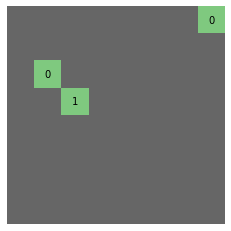

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

In [ ]:
train_minesweeper(episodes, episode_start, epsilon, global_step)

Exception ignored in: <bound method IteratorResourceDeleter.__del__ of <tensorflow.python.data.ops.iterator_ops.IteratorResourceDeleter object at 0x7f1f70042e48>>
Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/tensorflow/python/data/ops/iterator_ops.py", line 532, in __del__
    if self._eager_mode:
AttributeError: _eager_mode


ep: 1   s.: -24.3   mem.len: 1296   eps: 0.7   g_step: 1296   av_q: 0.347   av_loss: 0.0
ep: 2   s.: -21.9   mem.len: 2592   eps: 0.7   g_step: 2592   av_q: 0.344   av_loss: 0.0
ep: 3   s.: -24.3   mem.len: 3888   eps: 0.7   g_step: 3888   av_q: 0.338   av_loss: 0.0
ep: 4   s.: -24.3   mem.len: 5184   eps: 0.7   g_step: 5184   av_q: 0.34   av_loss: 0.0
ep: 5   s.: -23.1   mem.len: 6480   eps: 0.7   g_step: 6480   av_q: 0.365   av_loss: 0.0
ep: 6   s.: -1   mem.len: 6496   eps: 0.7   g_step: 6496   av_q: 0.336   av_loss: 0.0
ep: 7   s.: -24.3   mem.len: 7792   eps: 0.7   g_step: 7792   av_q: 0.364   av_loss: 0.0
ep: 8   s.: -24.3   mem.len: 9088   eps: 0.7   g_step: 9088   av_q: 0.36   av_loss: 0.0
ep: 9   s.: -23.1   mem.len: 10384   eps: 0.7   g_step: 10384   av_q: 0.37   av_loss: 0.0
ep: 10   s.: -23.1   mem.len: 11680   eps: 0.7   g_step: 11680   av_q: 0.368   av_loss: 0.0
ep: 11   s.: -21.9   mem.len: 12976   eps: 0.7   g_step: 12976   av_q: 0.345   av_loss: 0.0
ep: 12   s.: -1.3  

## 2 iteration

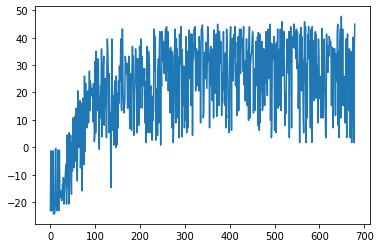

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/scores.npy')

plt.plot(scores_history)
plt.show()

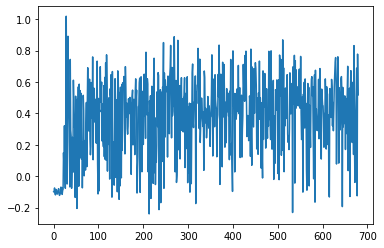

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/average_scores.npy')

plt.plot(scores_history)
plt.show()

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_size = 8
mines_count = 10
epsilon = 0.5
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


0.72     0.07     -0.52    -0.42    -0.44    -0.42    -0.43    -0.45    
-0.87    0.11     -0.44    -0.42    -0.45    -0.43    -0.43    -0.42    
0.42     -0.14    -0.44    -0.45    -0.44    -0.43    -0.42    -0.41    
-0.4     -0.48    -0.42    -0.46    -0.45    -0.44    -0.44    -0.42    
-0.42    -0.45    -0.47    -0.46    -0.45    -0.44    -0.43    -0.41    
-0.44    -0.46    -0.45    -0.45    -0.45    -0.44    -0.44    -0.42    
-0.45    -0.45    -0.45    -0.45    -0.45    -0.45    -0.45    -0.44    
-0.47    -0.44    -0.43    -0.43    -0.42    -0.42    -0.43    -0.42    



-0.54    0.25     -0.51    -0.4     -0.44    -0.42    -0.43    -0.45    
-0.67    0.15     -0.43    -0.43    -0.45    -0.43    -0.43    -0.42    
0.39     -0.17    -0.42    -0.45    -0.44    -0.43    -0.42    -0.41    
-0.39    -0.48    -0.43    -0.46    -0.45    -0.44    -0.44    -0.42    
-0.42    -0.45    -0.47    -0.46    -0.45    -0.44    -0.43    -0.41    
-0.44    -0.46    -0.45    -0.45    -0.45    -0

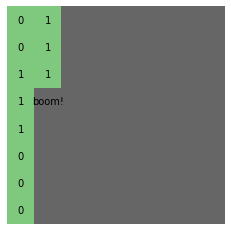

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

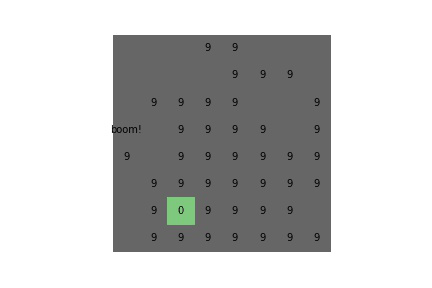

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
train_minesweeper(episodes, episode_start, epsilon, global_step)

ep: 680   s.: 21.5   mem.len: 313   eps: 0.5   g_step: 389136   av_q: 0.527   av_loss: 0.0
ep: 681   s.: 37.7   mem.len: 911   eps: 0.5   g_step: 389840   av_q: 0.52   av_loss: 0.0
ep: 682   s.: 39.5   mem.len: 1647   eps: 0.5   g_step: 390576   av_q: 0.685   av_loss: 0.0
ep: 683   s.: 39.5   mem.len: 2330   eps: 0.5   g_step: 391312   av_q: 0.619   av_loss: 0.0
ep: 684   s.: 34.5   mem.len: 3468   eps: 0.5   g_step: 392608   av_q: 0.341   av_loss: 0.0
ep: 685   s.: 44.0   mem.len: 4153   eps: 0.5   g_step: 393424   av_q: 0.506   av_loss: 0.0
ep: 686   s.: 7.1   mem.len: 4212   eps: 0.5   g_step: 393584   av_q: -0.069   av_loss: 0.0
ep: 687   s.: 35.7   mem.len: 5350   eps: 0.5   g_step: 394880   av_q: 0.299   av_loss: 0.0
ep: 688   s.: 25.1   mem.len: 5761   eps: 0.5   g_step: 395360   av_q: 0.702   av_loss: 0.0
ep: 689   s.: 39.5   mem.len: 6420   eps: 0.5   g_step: 396096   av_q: 0.55   av_loss: 0.0
ep: 690   s.: 15.3   mem.len: 7671   eps: 0.5   g_step: 397392   av_q: 0.43   av_los

## 3 iteration

batch_size = 16

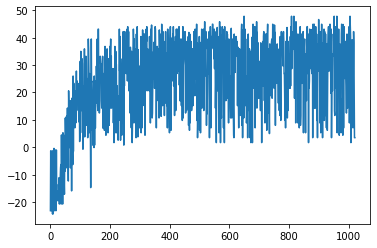

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/scores.npy')

plt.plot(scores_history)
plt.show()

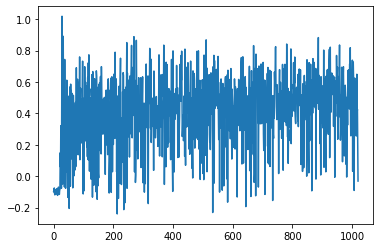

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/average_scores.npy')

plt.plot(scores_history)
plt.show()

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_size = 8
mines_count = 10
epsilon = 0.23
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-0.61    -0.49    -0.55    -0.37    -0.35    -0.33    -0.35    -0.34    
0.83     0.71     0.37     -0.48    -0.34    -0.3     -0.32    -0.28    
0.8      -0.37    0.4      -0.29    -0.29    -0.27    -0.28    -0.26    
0.5      0.59     0.24     -0.35    -0.27    -0.26    -0.27    -0.26    
-0.29    -0.34    -0.35    -0.23    -0.28    -0.26    -0.27    -0.29    
-0.15    -0.27    -0.2     -0.25    -0.29    -0.25    -0.27    -0.31    
-0.2     -0.27    -0.25    -0.25    -0.29    -0.27    -0.3     -0.37    
-0.2     -0.27    -0.26    -0.25    -0.32    -0.32    -0.36    -0.48    



0.63     0.15     -0.67    -0.36    -0.35    -0.33    -0.35    -0.34    
-0.23    0.97     0.4      -0.48    -0.34    -0.3     -0.32    -0.28    
1.07     -0.3     0.37     -0.29    -0.29    -0.27    -0.28    -0.26    
0.38     0.56     0.26     -0.35    -0.27    -0.26    -0.27    -0.26    
-0.28    -0.31    -0.35    -0.24    -0.28    -0.26    -0.27    -0.29    
-0.15    -0.27    -0.2     -0.25    -0.29    -0

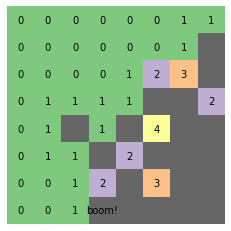

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

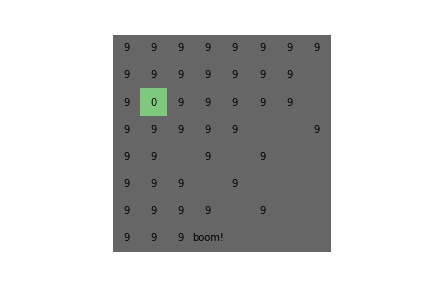

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
train_minesweeper(episodes, episode_start, epsilon, global_step)

ep: 1020   s.: 36.8   mem.len: 516   eps: 0.23   g_step: 594192   av_q: 0.465   av_loss: 0.0
ep: 1021   s.: 26.0   mem.len: 904   eps: 0.23   g_step: 594688   av_q: 0.553   av_loss: 0.0
ep: 1022   s.: 16.1   mem.len: 1102   eps: 0.23   g_step: 595008   av_q: 0.401   av_loss: 0.0
ep: 1023   s.: 34.1   mem.len: 1637   eps: 0.23   g_step: 595648   av_q: 0.62   av_loss: 0.0
ep: 1024   s.: 35.0   mem.len: 2140   eps: 0.23   g_step: 596304   av_q: 0.409   av_loss: 0.0
ep: 1025   s.: 25.1   mem.len: 2584   eps: 0.23   g_step: 596784   av_q: 0.814   av_loss: 0.0
ep: 1026   s.: 36.9   mem.len: 3707   eps: 0.23   g_step: 598080   av_q: 0.338   av_loss: 0.0
ep: 1027   s.: 34.1   mem.len: 4171   eps: 0.23   g_step: 598720   av_q: 0.441   av_loss: 0.0
ep: 1028   s.: 40.4   mem.len: 4783   eps: 0.23   g_step: 599472   av_q: 0.602   av_loss: 0.0
ep: 1029   s.: 31.4   mem.len: 5277   eps: 0.23   g_step: 600064   av_q: 0.728   av_loss: 0.0
ep: 1030   s.: 25.1   mem.len: 5561   eps: 0.23   g_step: 60054

## 4 iteration

batch_size = 16

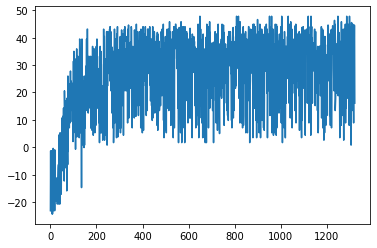

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/scores.npy')

plt.plot(scores_history)
plt.show()

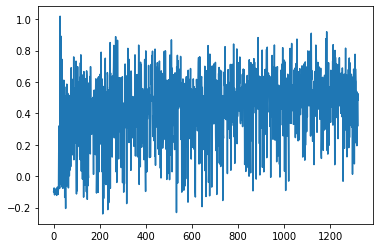

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/average_scores.npy')

plt.plot(scores_history)
plt.show()

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_size = 8
mines_count = 10
epsilon = 0.0
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-0.32    -0.33    -0.31    -0.31    -0.32    -0.31    -0.34    -0.37    
-0.33    -0.36    -0.33    -0.33    -0.32    -0.3     -0.31    -0.28    
-0.35    -0.31    -0.27    -0.27    -0.28    -0.26    -0.27    -0.24    
-0.09    -0.66    -0.36    -0.55    -0.29    -0.25    -0.26    -0.22    
-0.67    0.37     0.52     0.26     -0.42    -0.16    -0.23    -0.19    
-0.31    0.71     -0.47    0.53     -0.36    -0.22    -0.21    -0.18    
-0.56    0.85     0.94     0.55     -0.43    -0.19    -0.23    -0.2     
-0.12    -0.48    -0.23    -0.38    -0.08    -0.19    -0.22    -0.22    



-0.32    -0.33    -0.31    -0.31    -0.32    -0.31    -0.34    -0.37    
-0.33    -0.36    -0.33    -0.33    -0.32    -0.3     -0.31    -0.28    
-0.35    -0.31    -0.27    -0.27    -0.28    -0.26    -0.27    -0.24    
-0.13    -0.63    -0.33    -0.52    -0.29    -0.25    -0.26    -0.22    
-0.51    0.28     0.53     0.21     -0.43    -0.16    -0.23    -0.19    
-0.54    0.88     -0.2     0.64     -0.48    -0

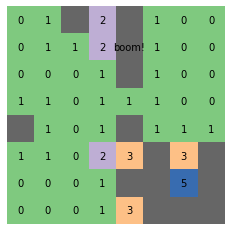

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

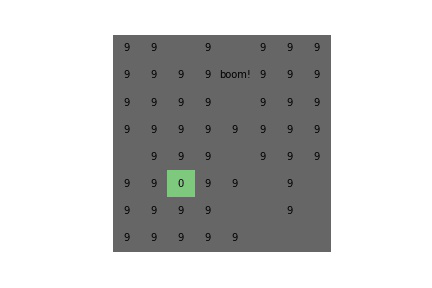

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
train_minesweeper(episodes, episode_start, epsilon, global_step)

ep: 1320   s.: 3.5   mem.len: 22   eps: 0.0   g_step: 781136   av_q: 0.068   av_loss: 0.0
ep: 1321   s.: 36.8   mem.len: 595   eps: 0.0   g_step: 781824   av_q: 0.608   av_loss: 0.0
ep: 1322   s.: 26.9   mem.len: 1019   eps: 0.0   g_step: 782336   av_q: 0.629   av_loss: 0.0
ep: 1323   s.: 24.2   mem.len: 1350   eps: 0.0   g_step: 782800   av_q: 0.623   av_loss: 0.0
ep: 1324   s.: 44.0   mem.len: 2078   eps: 0.0   g_step: 783616   av_q: 0.586   av_loss: 0.0
ep: 1325   s.: 37.7   mem.len: 2717   eps: 0.0   g_step: 784320   av_q: 0.711   av_loss: 0.0
ep: 1326   s.: 17.9   mem.len: 2938   eps: 0.0   g_step: 784672   av_q: 0.325   av_loss: 0.0
ep: 1327   s.: 33.2   mem.len: 3461   eps: 0.0   g_step: 785296   av_q: 0.689   av_loss: 0.0
ep: 1328   s.: 15.2   mem.len: 3657   eps: 0.0   g_step: 785600   av_q: 0.449   av_loss: 0.0
ep: 1329   s.: 38.1   mem.len: 4781   eps: 0.0   g_step: 786896   av_q: 0.284   av_loss: 0.0
ep: 1330   s.: 22.4   mem.len: 5016   eps: 0.0   g_step: 787328   av_q: 0.

## 5 iteration

batch_size = 16, advanced_mode = ON, mines_count = 11

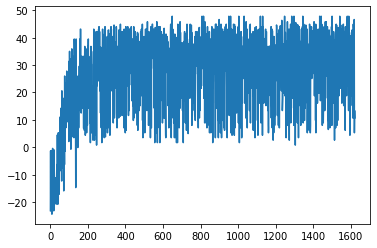

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/scores.npy')

plt.plot(scores_history)
plt.show()

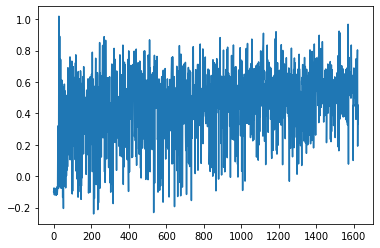

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/average_scores.npy')

plt.plot(scores_history)
plt.show()

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_size = 8
mines_count = 10
epsilon = 0.0
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-0.2     -0.1     -0.06    -0.09    -0.07    -0.09    -0.14    -0.1     
-0.16    -0.17    -0.14    -0.18    -0.16    -0.16    -0.19    -0.09    
-0.08    -0.11    -0.11    -0.18    -0.09    -0.06    -0.18    -0.09    
-0.09    -0.13    -0.18    -0.11    -0.43    -0.36    -0.53    -0.19    
-0.08    -0.13    -0.06    -0.4     0.28     0.55     0.4      -0.36    
-0.07    -0.1     -0.06    -0.2     0.53     -1.03    0.76     -0.34    
-0.14    -0.15    -0.13    -0.31    0.59     0.88     0.88     -0.72    
-0.18    -0.13    -0.17    0.07     -0.44    -0.3     -0.7     0.15     



-0.2     -0.1     -0.06    -0.09    -0.07    -0.09    -0.14    -0.1     
-0.16    -0.17    -0.14    -0.18    -0.16    -0.16    -0.19    -0.09    
-0.08    -0.11    -0.11    -0.18    -0.09    -0.06    -0.18    -0.09    
-0.09    -0.13    -0.18    -0.12    -0.44    -0.33    -0.47    -0.17    
-0.08    -0.13    -0.06    -0.43    0.29     0.44     0.38     -0.67    
-0.07    -0.1     -0.06    -0.16    0.48     -0

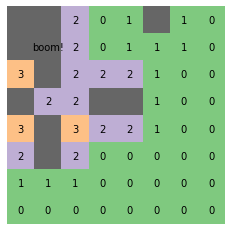

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

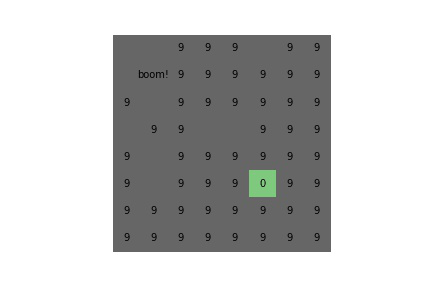

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_size = 8
mines_count = 11
epsilon = 0.0
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(playfield_size, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-0.33    -0.01    0.04     -0.15    -0.1     -0.11    -0.14    -0.1     
-0.03    -0.83    -0.39    -0.49    -0.25    -0.11    -0.19    -0.09    
-0.62    0.71     0.76     0.39     -0.33    -0.05    -0.15    -0.05    
-0.26    0.73     -1.08    0.48     -0.17    -0.24    -0.15    -0.07    
-0.32    0.84     0.94     0.58     -0.44    -0.06    -0.14    -0.08    
0.16     -0.54    -0.35    -0.36    -0.03    -0.08    -0.11    -0.09    
-0.2     -0.1     -0.16    -0.12    -0.13    -0.2     -0.14    -0.14    
-0.18    -0.13    -0.12    -0.1     -0.1     -0.11    -0.11    -0.17    



-0.33    -0.01    0.04     -0.15    -0.1     -0.11    -0.14    -0.1     
-0.08    -0.8     -0.2     -0.47    -0.2     -0.2     -0.19    -0.09    
-0.45    0.6      0.72     0.46     -0.46    0.01     -0.15    -0.05    
-0.35    0.93     -0.82    0.54     -0.18    -0.24    -0.15    -0.07    
-0.41    0.96     -0.7     0.65     -0.55    -0.03    -0.14    -0.08    
0.12     0.06     0.17     0.02     -0.14    -0

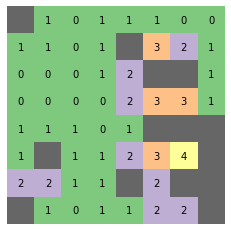

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

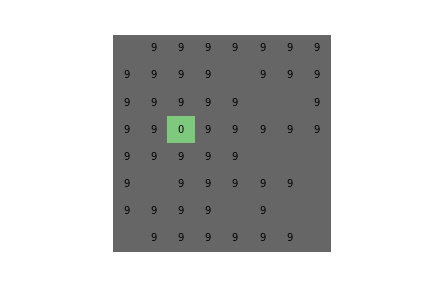

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
train_minesweeper(episodes, episode_start, epsilon, global_step, advanced=True)

ep: 1620   s.: 34.1   mem.len: 130   eps: 0.0   g_step: 963120   av_q: 0.458   av_loss: 0.0
ep: 1621   s.: 12.5   mem.len: 222   eps: 0.0   g_step: 963216   av_q: 0.69   av_loss: 0.0
ep: 1622   s.: 23.9   mem.len: 326   eps: 0.0   g_step: 963328   av_q: 0.607   av_loss: 0.0
ep: 1623   s.: 44.9   mem.len: 575   eps: 0.0   g_step: 963584   av_q: 0.41   av_loss: 0.0
ep: 1624   s.: 38.6   mem.len: 803   eps: 0.0   g_step: 963824   av_q: 0.487   av_loss: 0.0
ep: 1625   s.: 23.3   mem.len: 900   eps: 0.0   g_step: 963936   av_q: 0.463   av_loss: 0.0
ep: 1626   s.: 23.3   mem.len: 1008   eps: 0.0   g_step: 964064   av_q: 0.438   av_loss: 0.0
ep: 1627   s.: 22.2   mem.len: 2289   eps: 0.0   g_step: 965360   av_q: 0.294   av_loss: 0.0
ep: 1628   s.: 34.1   mem.len: 2365   eps: 0.0   g_step: 965440   av_q: 0.581   av_loss: 0.0
ep: 1629   s.: 17.0   mem.len: 2524   eps: 0.0   g_step: 965632   av_q: 0.497   av_loss: 0.0
ep: 1630   s.: 15.2   mem.len: 2553   eps: 0.0   g_step: 965680   av_q: 0.421 

## Check results

advanced_mode = ON, mines_count = 10

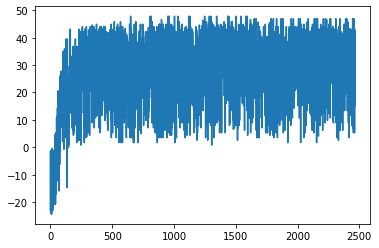

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/scores.npy')

plt.plot(scores_history)
plt.show()

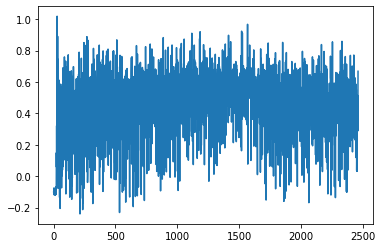

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/average_scores.npy')

plt.plot(scores_history)
plt.show()

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_size = 8
mines_count = 10
epsilon = 0.0
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-0.37    -0.3     -0.34    -0.39    -0.46    -0.53    -0.59    -0.65    
-0.39    -0.3     -0.31    -0.3     -0.32    -0.36    -0.38    -0.46    
-0.42    -0.32    -0.32    -0.3     -0.29    -0.31    -0.31    -0.39    
-0.43    -0.32    -0.39    -0.36    -0.23    -0.27    -0.28    -0.37    
-0.3     -0.61    -0.57    -0.55    -0.3     -0.3     -0.24    -0.32    
-0.85    0.39     -0.02    -0.12    -0.63    -0.26    -0.26    -0.33    
-0.68    0.49     -1.64    0.47     -0.62    -0.44    -0.3     -0.37    
-0.58    0.97     0.69     0.49     -0.71    -0.36    -0.41    -0.44    



0.15     0.06     0.33     0.38     -0.66    -0.36    -0.59    -0.65    
-0.73    -1.01    -1.34    0.28     -0.44    -0.25    -0.38    -0.46    
-0.99    -0.91    -1.41    0.47     -0.4     -0.16    -0.25    -0.39    
-0.69    -0.67    -1.42    0.28     -0.4     -0.25    -0.22    -0.37    
-0.65    -0.82    -1.59    -0.09    0.12     -0.45    -0.13    -0.32    
-0.71    -1.01    -1.17    -1.68    0.2      -0

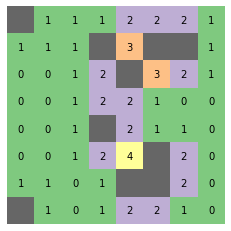

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

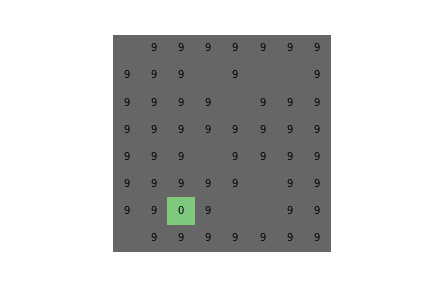

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
score = 0
n = 1000

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 4.0 %
200 games - winrate 8.5 %
300 games - winrate 11.0 %
400 games - winrate 10.0 %
500 games - winrate 9.4 %
600 games - winrate 8.67 %
700 games - winrate 8.29 %
800 games - winrate 8.25 %


In [ ]:
# Проверим winrate, когда минер не подорвался
score = 0
n = 1000

for i in range(1, n+1):
  curr_result = check_winrate(boom=True)
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 16.0 %
200 games - winrate 15.5 %


KeyboardInterrupt: ignored

## 6 iteration

batch_size = 16, advanced_mode = ON, playfield_size = 5, mines_count = 5

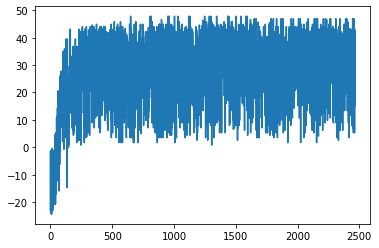

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/scores.npy')

plt.plot(scores_history)
plt.show()

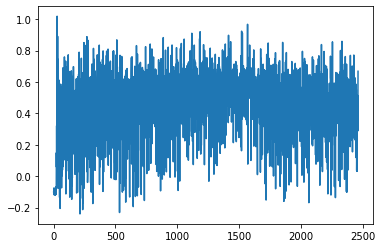

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/average_scores.npy')

plt.plot(scores_history)
plt.show()

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_size = 5
mines_count = 5
epsilon = 0.2
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-0.42    -0.2     -0.5     -0.61    -0.58    
-0.47    -0.01    -0.73    -0.46    -1.12    
-0.16    -0.81    0.87     0.5      0.29     
-0.44    -0.48    0.79     -0.95    0.71     
-0.27    -0.52    0.67     0.69     0.89     



-0.09    -0.68    0.89     -0.99    -0.7     
-0.52    1.15     0.45     -1.37    -1.15    
-0.58    0.63     -0.93    -1.29    -2.01    
-0.27    0.68     -1.04    -1.31    -2.17    
-0.32    -0.38    -1.9     -1.17    -0.9     



0.11     -0.45    0.81     -1.13    -0.55    
-0.25    -1.38    0.16     -1.74    -0.99    
-0.87    0.54     -0.91    -1.12    -1.95    
-0.19    0.92     -1.06    -1.31    -2.19    
-0.46    -0.05    -1.82    -1.07    -0.97    



0.05     -0.21    0.94     -1.06    -0.48    
-0.25    -1.44    0.17     -1.85    -0.89    
-0.43    0.57     -1.04    -1.59    -1.69    
0.19     -1.48    -1.39    -1.55    -1.9     
0.29     -0.32    -1.7     -1.27    -0.79    



-0.26    0.34     -0.79    -0.87    -1.01    
-0.23    -1.1     -0.

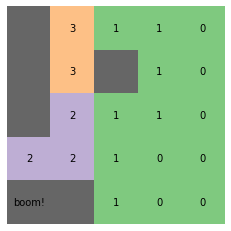

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

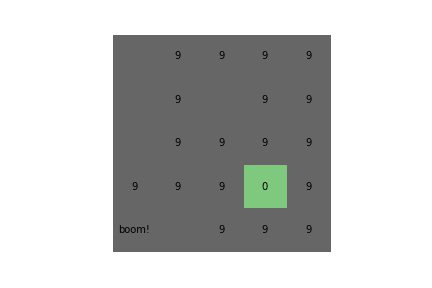

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
train_minesweeper(episodes, episode_start, epsilon, global_step, advanced=True)

Streaming output truncated to the last 5000 lines.
ep: 24502   s.: 12.5   mem.len: 40000   eps: 0.1   g_step: 1284702   av_q: 0.687   av_loss: 0.0130986
ep: 24503   s.: 11.6   mem.len: 40000   eps: 0.1   g_step: 1284711   av_q: 0.798   av_loss: 0.0088541
ep: 24504   s.: 15.2   mem.len: 40000   eps: 0.1   g_step: 1284726   av_q: 0.631   av_loss: 0.009534
ep: 24505   s.: 11.6   mem.len: 40000   eps: 0.1   g_step: 1284731   av_q: 0.673   av_loss: 0.0126004
ep: 24506   s.: 12.5   mem.len: 40000   eps: 0.1   g_step: 1284740   av_q: 0.695   av_loss: 0.0108417
ep: 24507   s.: 11.6   mem.len: 40000   eps: 0.1   g_step: 1284745   av_q: 0.56   av_loss: 0.0113392
ep: 24508   s.: 14.3   mem.len: 40000   eps: 0.1   g_step: 1284755   av_q: 0.687   av_loss: 0.0097507
ep: 24509   s.: 17.2   mem.len: 40000   eps: 0.1   g_step: 1284757   av_q: 0.715   av_loss: 0.0080251
ep: 24510   s.: 15.2   mem.len: 40000   eps: 0.1   g_step: 1284764   av_q: 0.79   av_loss: 0.0101513
ep: 24511   s.: 14.3   mem.len: 40

## 7 iteration

batch_size = 16, advanced_mode = ON, playfield_size = 5, mines_count = 5

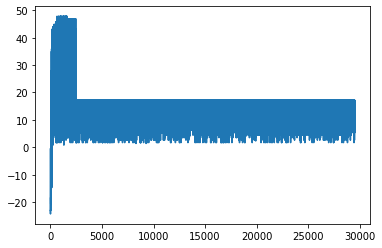

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/scores.npy')

plt.plot(scores_history)
plt.show()

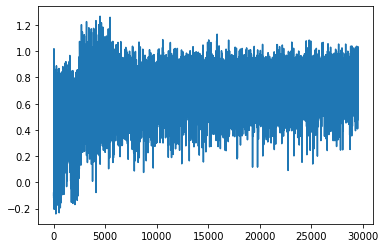

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/average_scores.npy')

plt.plot(scores_history)
plt.show()

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_size = 5
mines_count = 5
epsilon = 0.0
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-0.33    -0.15    -0.16    -0.14    -0.19    
-0.27    -0.2     0.12     -0.09    -0.08    
-0.19    -0.01    0.26     -0.56    -0.46    
-0.25    -0.04    -0.53    0.85     0.78     
-0.35    -0.02    -0.66    0.69     -0.83    



-0.27    -0.34    0.37     0.05     0.28     
0.74     0.81     0.08     -0.39    -0.69    
0.82     -0.18    -0.05    -0.53    -0.28    
-0.77    -0.01    -0.54    -0.51    -0.34    
-0.37    -0.74    -0.77    -0.21    0.06     



-0.39    -0.5     0.46     0.07     0.28     
0.71     1.09     -0.19    -0.3     -0.69    
-0.38    -0.31    -0.28    -0.35    -0.28    
-0.83    0.1      -0.67    -0.43    -0.34    
-0.58    -0.88    -0.67    -0.17    0.06     



0.35     0.16     0.95     0.18     0.37     
0.67     -0.04    -0.45    -0.48    -0.38    
-0.45    -0.49    -0.55    -0.46    -0.09    
-0.79    -0.23    -0.76    -0.52    -0.15    
-0.45    -0.7     -0.64    -0.16    0.01     



0.57     -0.06    -0.2     -0.16    0.65     
0.85     -0.06    -0.

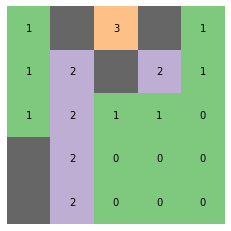

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

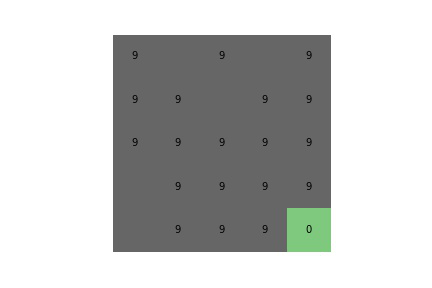

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
score = 0
n = 500

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 46.0 %
200 games - winrate 43.5 %
300 games - winrate 44.67 %
400 games - winrate 44.5 %
500 games - winrate 45.0 %
Total winrate 45.0 %


In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_size = 8
mines_count = 10
epsilon = 0.0
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-0.33    -0.24    -0.21    -0.19    -0.16    -0.16    -0.16    -0.19    
-0.3     -0.21    -0.16    -0.14    -0.11    -0.11    -0.13    -0.18    
-0.26    -0.18    -0.14    -0.12    -0.1     -0.11    -0.14    -0.18    
-0.24    -0.18    -0.11    -0.16    -0.1     -0.14    -0.13    -0.18    
-0.09    -0.46    -0.3     -0.31    -0.03    -0.11    -0.15    -0.19    
-0.64    0.55     0.36     0.31     -0.38    -0.16    -0.17    -0.2     
-0.57    0.71     -0.62    0.53     -0.41    -0.25    -0.17    -0.21    
-0.91    0.87     0.68     0.55     -0.54    -0.21    -0.21    -0.25    



-0.11    -0.39    -0.37    -0.43    -0.11    -0.16    -0.16    -0.19    
-0.0     0.29     0.37     0.43     -0.23    -0.13    -0.13    -0.18    
-0.62    -0.42    -0.4     0.47     0.02     -0.11    -0.13    -0.22    
-0.66    -0.26    -0.44    0.38     -0.18    -0.13    -0.11    -0.13    
-0.33    -0.4     -0.51    -0.14    0.35     0.52     -0.19    -0.11    
-0.19    -0.36    -0.35    -0.67    -0.59    -0

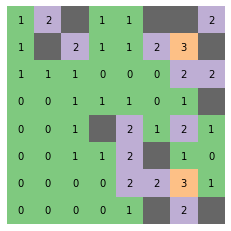

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

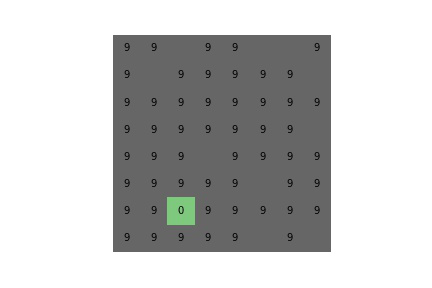

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
score = 0
n = 500

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 19.0 %
200 games - winrate 15.5 %
300 games - winrate 16.67 %
400 games - winrate 16.75 %
500 games - winrate 18.4 %
Total winrate 18.4 %


In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_size = 5
mines_count = 5
epsilon = 0.5
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-0.28    -0.22    -0.09    -0.22    -0.14    
0.07     -0.66    -0.28    -0.58    0.08     
-0.74    0.95     0.74     0.78     -0.68    
-0.35    0.79     -0.02    0.68     -0.46    
-0.91    0.96     0.61     0.86     -0.85    



-0.33    -0.07    -0.13    0.06     -0.05    
0.48     0.2      0.55     -0.71    -0.1     
0.89     -0.14    -0.2     -0.65    -0.37    
0.24     -0.14    -0.3     -0.54    -0.43    
0.23     -0.39    -0.45    -0.47    -0.2     



-0.27    -0.08    -0.14    0.1      -0.05    
0.34     0.09     0.75     -0.64    -0.1     
-0.5     -0.26    -0.2     -0.46    -0.37    
-0.03    -0.27    -0.3     -0.46    -0.43    
0.3      -0.47    -0.45    -0.31    -0.2     



-0.32    0.49     0.41     0.88     -0.16    
0.3      -0.38    -0.39    -0.98    -0.28    
-0.63    -0.42    -0.63    -0.74    -0.54    
0.06     -0.21    -0.5     -0.46    -0.36    
0.35     -0.36    -0.4     -0.33    -0.12    



-0.15    0.39     0.62     -0.29    0.43     
0.25     -0.38    -0.

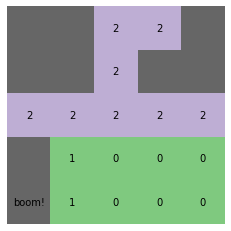

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

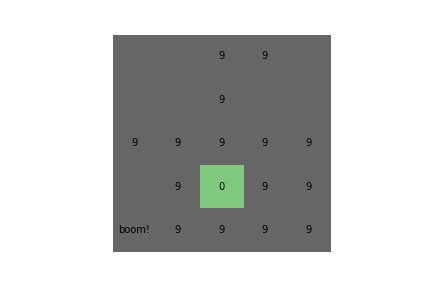

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
train_minesweeper(episodes, episode_start, epsilon, global_step, advanced=True)

Streaming output truncated to the last 5000 lines.
ep: 41940   s.: 14.9   mem.len: 40000   eps: 0.39   g_step: 1401991   av_q: 0.336   av_loss: 0.0107774
ep: 41941   s.: 11.6   mem.len: 40000   eps: 0.39   g_step: 1401996   av_q: 0.632   av_loss: 0.0127763
ep: 41942   s.: 13.4   mem.len: 40000   eps: 0.39   g_step: 1402002   av_q: 0.648   av_loss: 0.0129163
ep: 41943   s.: 14.9   mem.len: 40000   eps: 0.39   g_step: 1402005   av_q: 0.31   av_loss: 0.008163
ep: 41944   s.: 17.2   mem.len: 40000   eps: 0.39   g_step: 1402016   av_q: 0.686   av_loss: 0.0114933
ep: 41945   s.: 17.2   mem.len: 40000   eps: 0.39   g_step: 1402021   av_q: 0.502   av_loss: 0.0082339
ep: 41946   s.: 14.3   mem.len: 40000   eps: 0.39   g_step: 1402028   av_q: 0.537   av_loss: 0.0125137
ep: 41947   s.: 13.4   mem.len: 40000   eps: 0.39   g_step: 1402037   av_q: 0.568   av_loss: 0.0114957
ep: 41948   s.: 4.4   mem.len: 40000   eps: 0.39   g_step: 1402040   av_q: 0.744   av_loss: 0.0135866
ep: 41949   s.: 17.2   me

## 8 iteration

batch_size = 16, advanced_mode = ON, playfield_size = 5, mines_count = 5

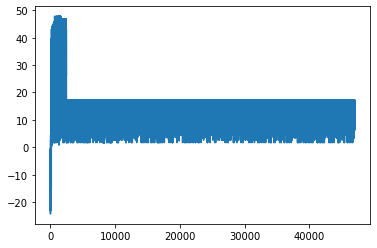

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/scores.npy')

plt.plot(scores_history)
plt.show()

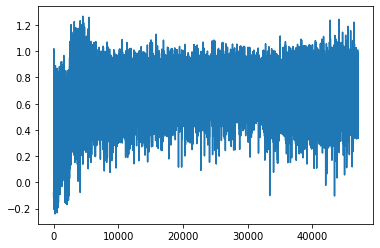

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/average_scores.npy')

plt.plot(scores_history)
plt.show()

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_size = 5
mines_count = 5
epsilon = 0.32
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_size)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-0.37    -0.53    0.96     -1.12    0.88     
-0.3     -0.49    0.81     0.72     0.68     
-0.49    -0.1     -0.55    -0.57    -0.75    
-0.54    -0.42    -0.38    -0.49    -0.5     
-0.46    -0.41    -0.49    -0.4     -0.43    



-0.25    -1.23    -1.4     -1.53    -1.34    
-0.11    -1.21    -1.06    -1.34    -1.48    
0.42     0.58     0.72     0.29     0.28     
-0.52    -0.67    -0.29    -0.43    -0.56    
-0.54    -0.41    -0.59    -0.47    -0.58    



-0.35    -1.45    -1.54    -1.71    -1.42    
-0.15    -1.35    -1.46    -1.48    -1.61    
0.22     0.22     -0.53    -0.16    0.16     
-0.51    0.1      0.22     0.36     -0.5     
-0.57    -0.36    -0.58    -0.26    -0.61    



-0.44    -1.35    -1.53    -1.51    -1.32    
-0.17    -1.5     -1.63    -1.97    -1.76    
0.31     0.04     -0.12    0.21     0.58     
-0.4     -0.22    0.41     -1.42    0.26     
-0.51    -0.27    0.38     0.6      0.31     



-0.44    -1.35    -1.53    -1.51    -1.32    
-0.26    -1.44    -1.

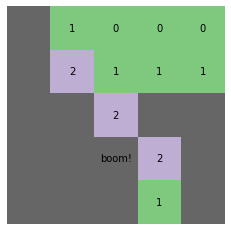

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

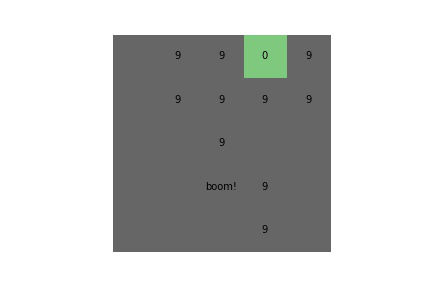

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
train_minesweeper(episodes, episode_start, epsilon, global_step, advanced=True)

Streaming output truncated to the last 5000 lines.
ep: 71057   s.: 17.2   mem.len: 40000   eps: 0.1   g_step: 1601159   av_q: 0.778   av_loss: 0.009821
ep: 71058   s.: 17.2   mem.len: 40000   eps: 0.1   g_step: 1601166   av_q: 0.621   av_loss: 0.0080798
ep: 71059   s.: 8.9   mem.len: 40000   eps: 0.1   g_step: 1601169   av_q: 0.814   av_loss: 0.0080029
ep: 71060   s.: 15.2   mem.len: 40000   eps: 0.1   g_step: 1601181   av_q: 0.734   av_loss: 0.0066194
ep: 71061   s.: 4.4   mem.len: 40000   eps: 0.1   g_step: 1601184   av_q: 0.811   av_loss: 0.0055953
ep: 71062   s.: 17.2   mem.len: 40000   eps: 0.1   g_step: 1601193   av_q: 0.762   av_loss: 0.0058523
ep: 71063   s.: 14.9   mem.len: 40000   eps: 0.1   g_step: 1601198   av_q: 0.541   av_loss: 0.0035596
ep: 71064   s.: 15.2   mem.len: 40000   eps: 0.1   g_step: 1601203   av_q: 0.835   av_loss: 0.0057981
ep: 71065   s.: 17.2   mem.len: 40000   eps: 0.1   g_step: 1601207   av_q: 0.841   av_loss: 0.004193
ep: 71066   s.: 17.2   mem.len: 400

## 9 iteration

batch_size = 16, advanced_mode = ON, playfield_size = 5, mines_count = 5

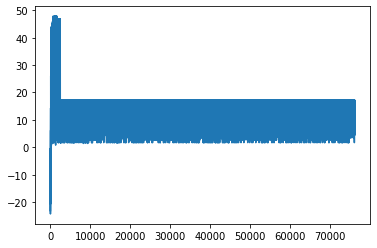

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/scores.npy')

plt.plot(scores_history)
plt.show()

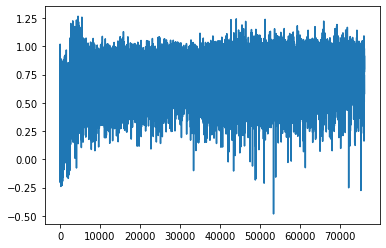

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/average_scores.npy')

plt.plot(scores_history)
plt.show()

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_h = 5
playfield_w = 5
mines_count = 5
epsilon = 0.0
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_h, playfield_w)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-1.3     0.9      -0.45    -0.36    -0.39    
0.68     0.6      -0.25    -0.03    -0.16    
-0.52    -0.34    0.12     -0.11    -0.27    
-0.23    -0.21    -0.25    -0.14    -0.2     
-0.43    -0.19    -0.32    -0.13    -0.21    



-1.09    -1.9     -1.52    -2.14    -1.12    
-1.33    -1.92    -1.29    -2.26    -1.54    
0.85     -0.43    1.05     -0.56    0.79     
-0.51    -0.36    -0.24    -0.1     -0.37    
-0.54    -0.48    -0.55    -0.58    -0.34    



-1.08    -1.89    -1.89    -2.15    -1.07    
-1.58    -1.97    -1.88    -2.47    -1.6     
0.89     -0.72    -0.6     -0.82    0.92     
-0.31    0.09     0.04     0.3      -0.18    
-0.57    -0.31    -0.38    -0.24    -0.42    



-1.08    -1.79    -2.03    -2.58    -1.3     
-1.58    -1.82    -1.88    -2.58    -2.26    
0.89     -0.29    -0.58    -1.3     -0.53    
-0.31    0.26     0.39     0.34     0.17     
-0.57    -0.23    -0.29    -0.15    -0.12    



-1.16    -2.02    -2.33    -2.3     -1.3     
-1.88    -2.15    -1.

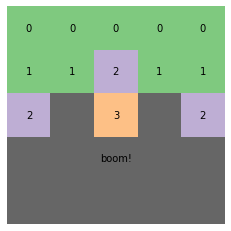

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
score = 0
n = 500

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 55.0 %
200 games - winrate 57.0 %
300 games - winrate 57.33 %
400 games - winrate 56.75 %
500 games - winrate 57.2 %
Total winrate 57.2 %


In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_h = 6
playfield_w = 6
mines_count = 5
epsilon = 0.0
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_h, playfield_w)
agent = Agent(dicision_field, epsilon)

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
score = 0
n = 500

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 57.0 %
200 games - winrate 61.5 %
300 games - winrate 61.67 %
400 games - winrate 64.5 %
500 games - winrate 65.6 %
Total winrate 65.6 %


In [ ]:
playfield_h = 8
playfield_w = 8
mines_count = 9
test_minesweeper = Minesweeper(mines_count, playfield_h, playfield_w)

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
score = 0
n = 500

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 33.0 %
200 games - winrate 38.0 %
300 games - winrate 37.0 %
400 games - winrate 37.75 %
500 games - winrate 40.0 %
Total winrate 40.0 %


In [ ]:
playfield_h = 8
playfield_w = 8
mines_count = 10
test_minesweeper = Minesweeper(mines_count, playfield_h, playfield_w)

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
score = 0
n = 500

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 31.0 %
200 games - winrate 28.5 %
300 games - winrate 26.33 %
400 games - winrate 26.25 %
500 games - winrate 27.0 %
Total winrate 27.0 %


In [ ]:
playfield_h = 10
playfield_w = 8
mines_count = 10
test_minesweeper = Minesweeper(mines_count, playfield_h, playfield_w)

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
score = 0
n = 500

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 50.0 %
200 games - winrate 48.0 %
300 games - winrate 47.33 %
400 games - winrate 47.25 %
500 games - winrate 48.0 %
Total winrate 48.0 %


In [ ]:
step_field = test_minesweeper_game()


-0.29    -0.24    -0.26    -0.25    -0.28    -0.3     -0.3     -0.39    -0.2     -0.16    
-0.16    -0.15    -0.17    -0.19    -0.19    -0.28    -0.21    -0.16    -0.16    -0.15    
-0.16    -0.18    -0.2     -0.27    -0.22    -0.17    -0.17    -0.15    -0.16    -0.18    
-0.19    -0.26    -0.26    -0.2     -0.2     -0.18    -0.17    -0.19    -0.18    -0.25    
-0.3     -0.18    -0.24    -0.25    -0.24    -0.17    -0.21    -0.25    -0.26    -0.16    
-0.45    -0.26    -0.36    -0.14    -0.11    -0.21    -0.32    -0.51    0.49     0.51     
0.47     -0.45    -0.23    -0.23    -0.33    -0.54    0.84     -1.01    0.76     -0.58    
-0.31    -0.21    -0.58    -0.68    0.8      0.59     0.73     -0.63    -0.19    -0.21    



-0.29    -0.24    -0.26    -0.25    -0.28    -0.3     -0.3     -0.39    -0.2     -0.16    
-0.16    -0.15    -0.17    -0.19    -0.19    -0.28    -0.21    -0.16    -0.16    -0.15    
-0.16    -0.18    -0.2     -0.27    -0.25    -0.16    -0.21    -0.16    -0.17    -0.18

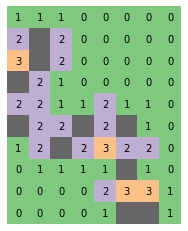

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

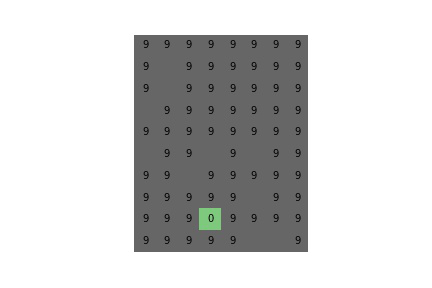

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
train_minesweeper(episodes, episode_start, epsilon, global_step, advanced=True)

Streaming output truncated to the last 5000 lines.
ep: 99243   s.: 14.3   mem.len: 40000   eps: 0.0   g_step: 1798917   av_q: 0.406   av_loss: 0.0112675
ep: 99244   s.: 9.8   mem.len: 40000   eps: 0.0   g_step: 1798919   av_q: 0.245   av_loss: 0.012533
ep: 99245   s.: 15.0   mem.len: 40000   eps: 0.0   g_step: 1798926   av_q: 0.273   av_loss: 0.013186
ep: 99246   s.: 17.2   mem.len: 40000   eps: 0.0   g_step: 1798930   av_q: 0.998   av_loss: 0.0125264
ep: 99247   s.: 14.3   mem.len: 40000   eps: 0.0   g_step: 1798942   av_q: 0.522   av_loss: 0.0164521
ep: 99248   s.: 17.2   mem.len: 40000   eps: 0.0   g_step: 1798949   av_q: 0.589   av_loss: 0.0113998
ep: 99249   s.: 9.8   mem.len: 40000   eps: 0.0   g_step: 1798953   av_q: 0.24   av_loss: 0.0142727
ep: 99250   s.: 17.2   mem.len: 40000   eps: 0.0   g_step: 1798960   av_q: 0.547   av_loss: 0.0111498
ep: 99251   s.: 17.2   mem.len: 40000   eps: 0.0   g_step: 1798967   av_q: 0.631   av_loss: 0.0145967
ep: 99252   s.: 17.2   mem.len: 4000

## Check results

batch_size = 16, advanced_mode = ON, playfield_size = 5, mines_count = 5

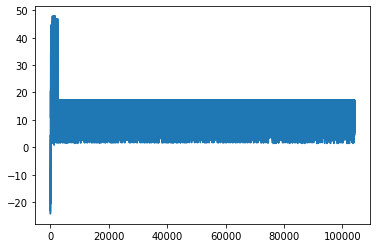

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/scores.npy')

plt.plot(scores_history)
plt.show()

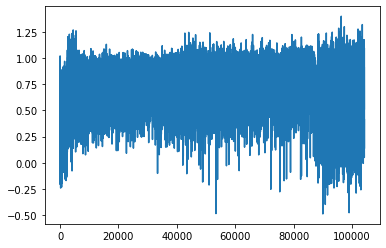

In [ ]:
scores_history = np.load('/content/drive/MyDrive/diplom/variant_3/average_scores.npy')

plt.plot(scores_history)
plt.show()

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_h = 5
playfield_w = 5
mines_count = 5
epsilon = 0.0
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_h, playfield_w)
agent = Agent(dicision_field, epsilon)

In [ ]:
step_field = test_minesweeper_game()


-0.67    -0.54    -1.83    -1.28    -2.41    
-0.65    -1.16    0.54     0.4      0.44     
-0.93    -0.75    0.71     -2.1     0.05     
-1.15    -1.49    0.44     0.45     0.38     
-1.12    -0.17    -1.94    -0.92    -2.41    



-1.6     0.54     -2.42    -2.0     -4.35    
-0.95    -1.94    -3.26    -3.36    -4.97    
-1.41    0.88     -2.89    -1.96    -5.81    
-1.17    -1.94    -3.17    -3.8     -5.47    
-1.82    0.5      -2.8     -1.79    -4.64    



-1.18    0.35     -2.28    -2.26    -3.71    
-0.91    -2.2     -2.8     -2.93    -4.22    
-0.73    -1.47    -3.38    -2.44    -4.03    
-0.81    -2.11    -3.18    -3.53    -4.93    
-1.63    0.61     -3.33    -1.73    -4.31    



-1.18    0.35     -2.28    -2.26    -3.71    
-0.7     -1.37    -2.39    -2.39    -4.3     
0.07     -1.32    -2.63    -2.93    -3.43    
-1.61    -2.7     -3.79    -2.59    -4.15    
-1.31    -1.14    -4.56    -1.24    -3.17    



-0.5     -2.14    -2.94    -2.65    -2.48    
-0.18    -1.35    -2.

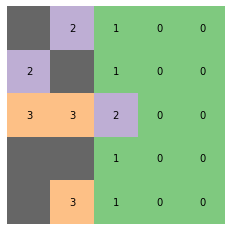

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
score = 0
n = 500

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 57.0 %
200 games - winrate 57.0 %
300 games - winrate 53.33 %
400 games - winrate 52.75 %
500 games - winrate 52.4 %
Total winrate 52.4 %


In [ ]:
playfield_h = 8
playfield_w = 8
mines_count = 10
test_minesweeper = Minesweeper(mines_count, playfield_h, playfield_w)

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
score = 0
n = 500

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 32.0 %
200 games - winrate 31.0 %
300 games - winrate 30.33 %
400 games - winrate 29.5 %
500 games - winrate 29.6 %
Total winrate 29.6 %


In [ ]:
step_field = test_minesweeper_game()


-0.94    -1.46    0.08     0.59     0.4      -2.2     -0.85    -1.06    
-0.66    -1.16    0.61     -2.41    0.71     -1.3     -1.11    -0.91    
-0.86    -1.13    0.19     0.24     0.05     -1.33    -0.91    -0.97    
-0.71    -0.41    -1.08    -0.72    -1.17    -0.46    -0.81    -0.98    
-0.85    -0.71    -0.68    -0.84    -0.8     -0.87    -0.85    -0.99    
-0.8     -0.71    -0.73    -0.72    -0.79    -0.84    -0.87    -1.06    
-0.82    -0.74    -0.79    -0.77    -0.83    -0.88    -0.88    -1.05    
-0.96    -0.83    -0.87    -0.84    -0.87    -0.92    -0.91    -1.08    



-1.63    0.4      -2.42    -2.34    -3.5     -2.69    -3.5     -3.34    
0.35     -1.25    -2.88    -2.76    -2.82    -3.6     -2.8     -2.1     
-1.67    -2.95    -3.42    -3.22    -3.72    -2.33    -2.42    -1.74    
-1.33    -1.89    -2.89    -2.66    -2.84    -2.7     -1.17    0.05     
-1.83    -2.56    -2.21    -2.34    -2.99    -1.21    0.02     -1.03    
-0.18    -0.16    0.59     -0.26    -0.16    0.

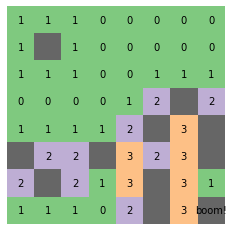

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

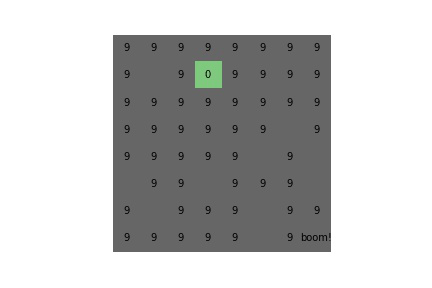

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
step_field = test_minesweeper_game()


-0.67    -0.57    -0.59    -0.71    -0.81    -0.64    -0.63    -1.06    
-0.37    -0.34    -0.37    -0.43    -0.5     -0.41    -0.41    -0.65    
-0.46    -0.34    -0.35    -0.43    -0.49    -0.41    -0.43    -0.7     
-0.6     -0.44    -0.46    -0.57    -0.65    -0.52    -0.54    -0.92    
-0.65    -0.44    -0.48    -0.58    -0.68    -0.55    -0.57    -0.87    
-0.57    -0.38    -0.39    -0.41    -0.69    -0.54    -0.73    -0.68    
-0.58    -0.41    -0.49    -0.68    -0.15    -0.0     0.03     -1.41    
-0.96    -0.59    -0.66    -1.25    0.23     -1.89    0.42     -2.21    



-0.67    -0.57    -0.59    -0.71    -0.81    -0.64    -0.63    -1.06    
-0.37    -0.34    -0.37    -0.43    -0.5     -0.41    -0.41    -0.65    
-0.5     -0.41    -0.45    -0.48    -0.56    -0.5     -0.53    -0.83    
-0.67    -0.56    -0.54    -0.72    -0.79    -0.82    -0.95    -1.35    
-0.81    -0.64    -0.33    -0.48    -0.99    0.03     0.02     0.3      
-0.83    -0.66    -0.25    -1.38    -1.62    -1

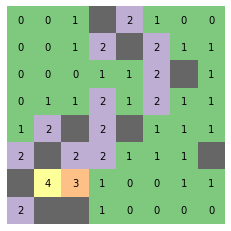

In [ ]:
result_dir = '/content/result_images/'

if os.path.exists(result_dir) is True:
  shutil.rmtree(result_dir)

os.mkdir(result_dir)

for i, field in enumerate(step_field):
  clear_output(wait=1000)
  show_result(field, i, test_minesweeper.free_point, test_minesweeper.mines_coord)

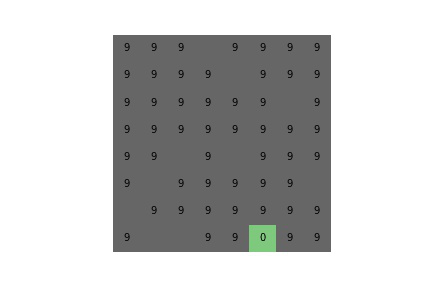

In [ ]:
images = [imageio.imread(os.path.join(result_dir, str(id) + '.jpg')) for id in range(len(os.listdir(result_dir)))]
imageio.mimsave('mw.gif', images)
Image(open('mw.gif','rb').read())

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
scale_factor = 1
score = 0
n = 200

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 29.0 %
200 games - winrate 32.5 %
Total winrate 32.5 %


In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
scale_factor = 2
score = 0
n = 200

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 33.0 %
200 games - winrate 31.5 %
Total winrate 31.5 %


In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
scale_factor = 0.5
score = 0
n = 200

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 33.0 %
200 games - winrate 34.0 %
Total winrate 34.0 %


In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
scale_factor = 3
score = 0
n = 200

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 28.0 %
200 games - winrate 31.0 %
Total winrate 31.0 %


In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
scale_factor = 0.3
score = 0
n = 200

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 32.0 %
200 games - winrate 36.0 %
Total winrate 36.0 %


In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
scale_factor = 5
score = 0
n = 200

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 25.0 %
200 games - winrate 25.5 %
Total winrate 25.5 %


In [ ]:
playfield_h = 8
playfield_w = 8
mines_count = 10
test_minesweeper = Minesweeper(mines_count, playfield_h, playfield_w)

In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
scale_factor = -0.5
score = 0
n = 200

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 31.0 %
200 games - winrate 24.5 %
Total winrate 24.5 %


In [ ]:
# Проверим winrate, когда минер открыл все свободные мины
scale_factor = 0.5
score = 0
n = 200

for i in range(1, n+1):
  curr_result = check_winrate()
  score += curr_result
  if i % 100 == 0:
    print(f'{i} games - winrate {round(score*100/i, 2)} %')

print(f'Total winrate {score*100/n} %')

100 games - winrate 30.0 %
200 games - winrate 34.0 %
Total winrate 34.0 %


In [ ]:
checkpoint_dir = '/content/drive/MyDrive/diplom/variant_3/'
episode_start, global_step = np.load(os.path.join(checkpoint_dir, 'step_info.npy')).tolist()
scores = np.load(os.path.join(checkpoint_dir, 'scores.npy')).tolist()
average_scores = np.load(os.path.join(checkpoint_dir, 'average_scores.npy')).tolist()
dicision_field = 5
playfield_h = 5
playfield_w = 5
mines_count = 5
epsilon = 0.0
episodes = 1000000

test_minesweeper = Minesweeper(mines_count, playfield_h, playfield_w)
agent = Agent(dicision_field, epsilon)

In [ ]:
train_minesweeper(episodes, episode_start, epsilon, global_step, advanced=True)

Streaming output truncated to the last 5000 lines.
ep: 133978   s.: 17.2   mem.len: 40000   eps: 0.0   g_step: 2041996   av_q: 0.9   av_loss: 0.0104553
ep: 133979   s.: 17.2   mem.len: 40000   eps: 0.0   g_step: 2042007   av_q: 0.627   av_loss: 0.0082497
ep: 133980   s.: 17.2   mem.len: 40000   eps: 0.0   g_step: 2042016   av_q: 0.737   av_loss: 0.0131929
ep: 133981   s.: 17.2   mem.len: 40000   eps: 0.0   g_step: 2042027   av_q: 0.915   av_loss: 0.0110303
ep: 133982   s.: 13.4   mem.len: 40000   eps: 0.0   g_step: 2042034   av_q: 0.643   av_loss: 0.0199968
ep: 133983   s.: 10.7   mem.len: 40000   eps: 0.0   g_step: 2042041   av_q: 0.832   av_loss: 0.0238774
ep: 133984   s.: 17.2   mem.len: 40000   eps: 0.0   g_step: 2042051   av_q: 0.805   av_loss: 0.0105363
ep: 133985   s.: 17.2   mem.len: 40000   eps: 0.0   g_step: 2042063   av_q: 0.768   av_loss: 0.012207
ep: 133986   s.: 17.2   mem.len: 40000   eps: 0.0   g_step: 2042069   av_q: 0.73   av_loss: 0.0119691
ep: 133987   s.: 17.2   me